<a href="https://colab.research.google.com/github/SeptiLutfiana/PCVK_Ganjil_2023/blob/main/Final_Crop_PCVK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Library

In [ ]:
from google.colab import drive
from google.colab.patches import cv2_imshow
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import imutils
from tensorflow.keras.models import load_model
from imutils.contours import sort_contours
import string
import matplotlib.pyplot as plt
from PIL import Image

# Load Directory

In [ ]:
# Mount Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Folder path containing images
folder_path = '/content/drive/MyDrive/pcvk/uas/datatest-uncrop/'

# Display Image

In [ ]:
# Function to display two images side by side for comparison
def compare_images(image1, title1, image2, title2):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
    plt.title(title1)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
    plt.title(title2)
    plt.axis('off')

    plt.show()

# Function to display an image using matplotlib
def display_image(image, title=''):
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Crop & Reshape Function

In [ ]:
def reshape_image(img):
    # Mendapatkan shape dari gambar
    height, width, channels = img.shape

    # Memeriksa apakah lebar atau tinggi lebih dari 2000
    if width > 2000 or height > 2000:
        # Melakukan reshape setengah dari gambar
        new_width = width // 2 - (width // 4)
        new_height = height // 2 - (height // 4)
        resized_img = cv2.resize(img, (new_width, new_height))

        return resized_img
    else:
        return img

def color_median_correction(img, filter_size):
    # Apply color median correction
    result = cv2.medianBlur(img, filter_size)

    return result

In [ ]:
# Function to cluster the image
def cluster_image(image, n_clusters=2):
    X = image.reshape(-1, 3)
    kmeans = KMeans(n_clusters=n_clusters, n_init=20)
    kmeans.fit(X)
    clustered_image = kmeans.cluster_centers_[kmeans.labels_]
    clustered_image = clustered_image.reshape(image.shape).astype(np.uint8)  # Ensure the correct data type
    return clustered_image

# Function to find and draw the largest contour
def find_and_draw_largest_contour(image, thresh_img):
    copy_thresh = thresh_img.copy()

    kernel_size = 10
    kernel = np.ones((kernel_size, kernel_size), np.uint8)

    copy_tresh = cv2.morphologyEx(copy_thresh, cv2.MORPH_OPEN, kernel)

    contours, _ = cv2.findContours(copy_thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    largest_area = 0
    largest_contour_index = -1

    for i, contour in enumerate(contours):
        area = cv2.contourArea(contour)
        if area > largest_area:
            largest_area = area
            largest_contour_index = i

    if largest_area >= ((image.shape[0]-(image.shape[0] * 0.1)) * image.shape[1]-(image.shape[0] * 0.1)):
        largest_area = 0
        largest_contour_index = -1

        # Reverse the color of the image
        inverted_img = 255 - thresh_img

        copy_tresh = cv2.morphologyEx(inverted_img, cv2.MORPH_OPEN, kernel)

        contours, _ = cv2.findContours(copy_tresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        for i, contour in enumerate(contours):
            area = cv2.contourArea(contour)
            if area > largest_area:
                largest_area = area
                largest_contour_index = i

    # Get the largest contour
    largest_contour = contours[largest_contour_index]

    # Draw the largest contour on the original image
    image_with_contour = image.copy()

    cv2.drawContours(image_with_contour, [largest_contour], -1, (0, 255, 0), thickness=5)

    # Display the image with the largest contour
    compare_images(image, "Original Image", image_with_contour, "Image with Largest Contour")

    return largest_contour


def perspective_transform(image, contour, padding=5):
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)

    if len(approx) == 4:
        M = cv2.moments(contour)
        cx = int(M['m10'] / M['m00'])
        cy = int(M['m01'] / M['m00'])

        points = sorted(approx, key=lambda point: np.arctan2(point[0][1] - cy, point[0][0] - cx))
        points = np.array([point[0] for point in points], dtype=np.float32)

        if points.shape != (4, 2):
            points = points.reshape((4, 2))

        # Ensure correct order for perspective transformation
        ordered_points = np.zeros_like(points)
        ordered_points[0] = points[np.argmin(points.sum(axis=1))]
        ordered_points[2] = points[np.argmax(points.sum(axis=1))]
        ordered_points[1] = points[np.argmin(np.diff(points, axis=1))]
        ordered_points[3] = points[np.argmax(np.diff(points, axis=1))]

        width = max(np.linalg.norm(ordered_points[0] - ordered_points[1]), np.linalg.norm(ordered_points[2] - ordered_points[3]))
        height = max(np.linalg.norm(ordered_points[1] - ordered_points[2]), np.linalg.norm(ordered_points[3] - ordered_points[0]))

        # Ensure width is greater than height
        if width < height:
            width, height = height, width

        # Add padding to the calculated width and height
        width += 2 * padding
        height += 2 * padding

        dst_pts = np.array([[padding, padding], [width - 1 - padding, padding],
                            [width - 1 - padding, height - 1 - padding], [padding, height - 1 - padding]], dtype=np.float32)

        if dst_pts.shape != (4, 2):
            dst_pts = dst_pts.reshape((4, 2))

        matrix = cv2.getPerspectiveTransform(ordered_points, dst_pts)
        warped_image = cv2.warpPerspective(image, matrix, (int(width), int(height)))

        # Display the original and warped images for comparison
        compare_images(image, "Original Image", warped_image, "Warped Image")

        return warped_image
    else:
        print("The largest contour does not have four points. Unable to perform perspective transformation.")
        return None

In [ ]:
def clustering(img):
  clustered_img = cluster_image(img, 10)
  clustered_img = cluster_image(clustered_img, 6)
  compare_images(img, "Original Image", clustered_img, "Clustered Image 6")
  clustered_img = cluster_image(clustered_img, 3)
  clustered_img = cluster_image(clustered_img, 2)
  return clustered_img

## Function If Contour not Detect

In [ ]:
def SecondOption(img):
  img2 = img.copy()
  img = color_median_correction(img,21)
  compare_images(img2, "Original Image", img, "Median Blur")
  clustered_img = clustering(img)
  gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

  upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
  compare_images(img2, "Original Image", thresh_img, "Thresh Image")

  # Find and draw the largest contour
  largest_contour = find_and_draw_largest_contour(img2, thresh_img)

  return largest_contour

# Process Image

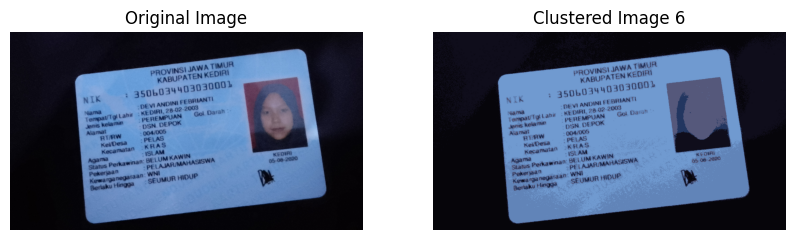

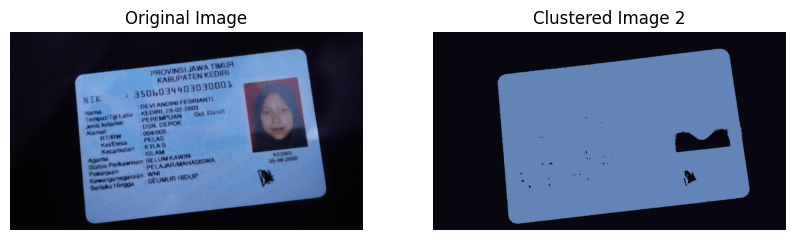

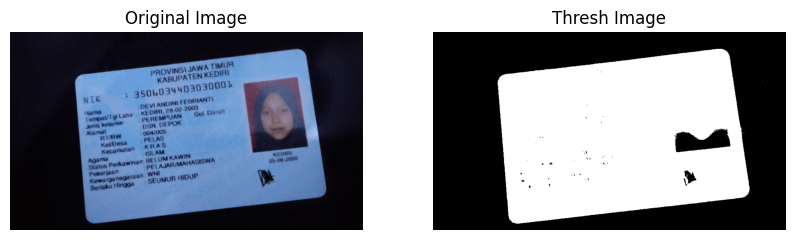

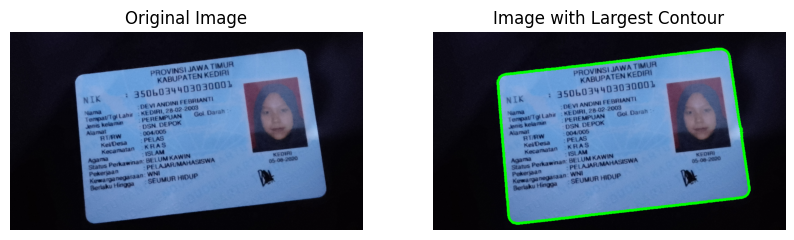

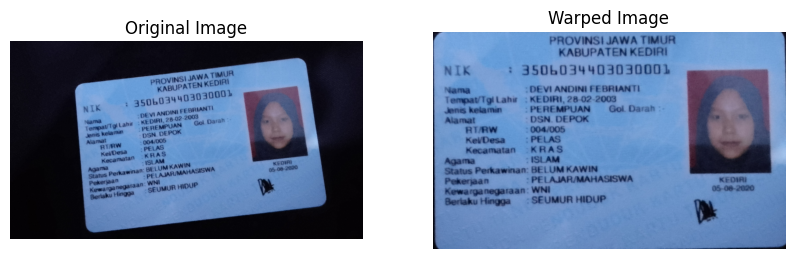

...

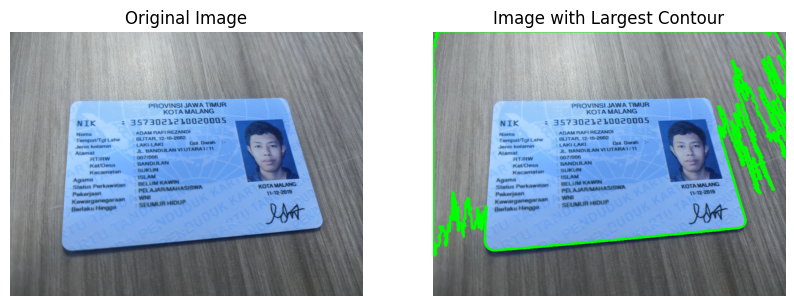

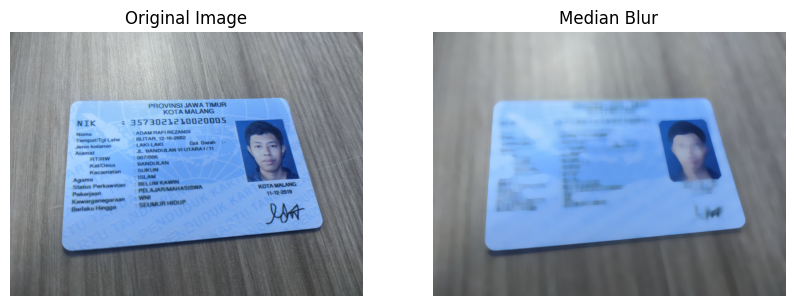

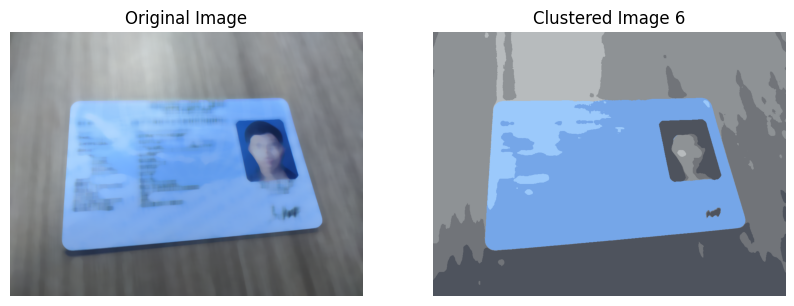

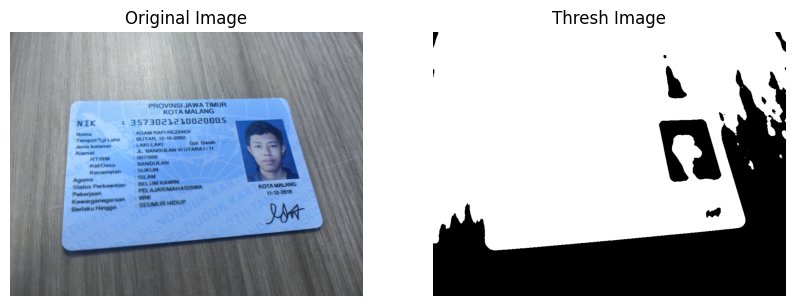

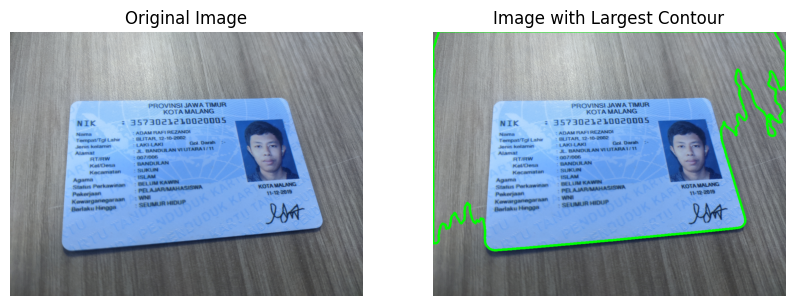

The largest contour does not have four points. Unable to perform perspective transformation.


error: ignored

In [ ]:
# Iterate over all files in the folder

for i,filename in enumerate(os.listdir(folder_path)):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        num_digits = len(str(len(os.listdir(folder_path))))

        file_ext = os.path.splitext(filename)[1]

        # Read the image
        image_path = os.path.join(folder_path, filename)

        img = cv2.imread(image_path)

        img = reshape_image(img)

        clustered = []

        if i == 14:
          img2 = color_median_correction(img,21)
          clustered_img = clustering(img2)
        else:
          clustered_img = clustering(img)

        compare_images(img, "Original Image", clustered_img, "Clustered Image 2")

        gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

        upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        compare_images(img, "Original Image", thresh_img, "Thresh Image")

        # Find and draw the largest contour
        largest_contour = find_and_draw_largest_contour(img.copy(), thresh_img)


        # If not found contour
        epsilon = 0.02 * cv2.arcLength(largest_contour, True)
        approx = cv2.approxPolyDP(largest_contour, epsilon, True)

        if len(approx) != 4:
          largest_contour = SecondOption(img)

        # Perform perspective transformation
        warped_image = perspective_transform(img.copy(), largest_contour)
        cv2.imwrite(f"/content/drive/MyDrive/pcvk/uas/result-cropped/{i:0{num_digits}d}{file_ext}", warped_image)

# Optional

In [ ]:
def clustering(img):
  # clustered_img = cluster_image(img, 15)
  # compare_images(img, "Original Image", clustered_img, "Clustered Image 15")
  # clustered_img = cluster_image(clustered_img, 7)
  # compare_images(img, "Original Image", clustered_img, "Clustered Image 6")
  clustered_img = cluster_image(img, 9)
  cv2_imshow(clustered_img)

  clustered_img = cluster_image(clustered_img, 5)
  cv2_imshow(clustered_img)

  clustered_img = cluster_image(clustered_img, 3)
  cv2_imshow(clustered_img)
  clustered_img = cluster_image(clustered_img, 2)
  return clustered_img

In [ ]:
def SecondOption(img):
  img2 = img.copy()
  img = color_median_correction(img,99)

  compare_images(img2, "Original Image", img, "Median Blur")
  clustered_img = clustering(img)
  gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

  upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
  compare_images(img2, "Original Image", thresh_img, "Thresh Image")

  # Find and draw the largest contour
  largest_contour = find_and_draw_largest_contour(img2, thresh_img)

  return largest_contour

In [ ]:
# Folder path containing images
folder_path = '/content/drive/MyDrive/pcvk/uas/datatest-uncrop2/'

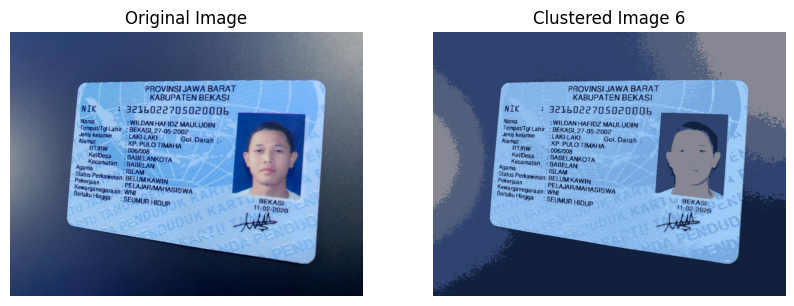

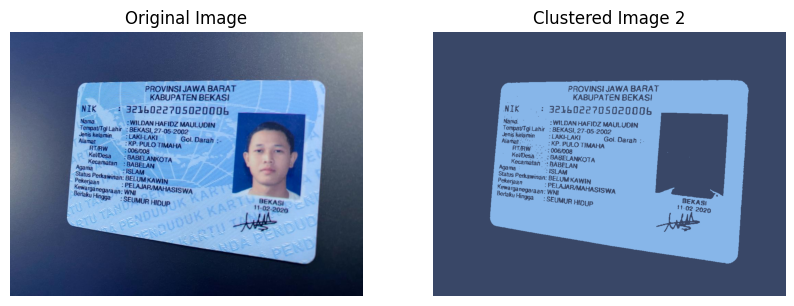

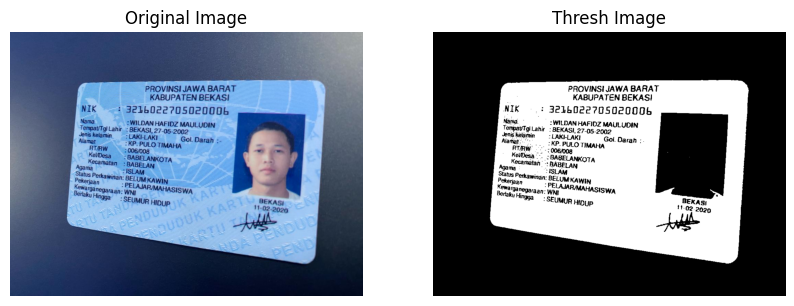

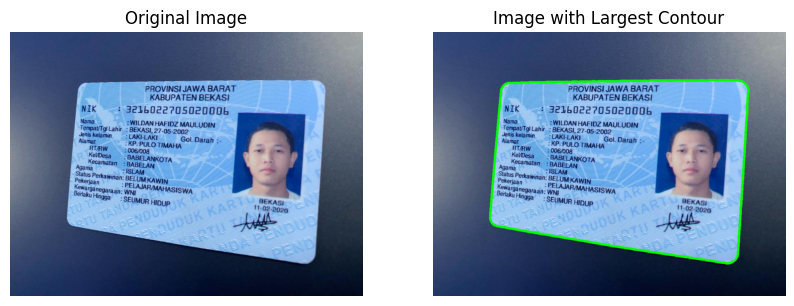

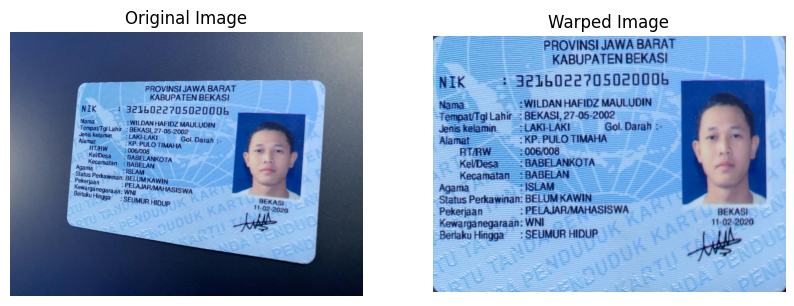

...

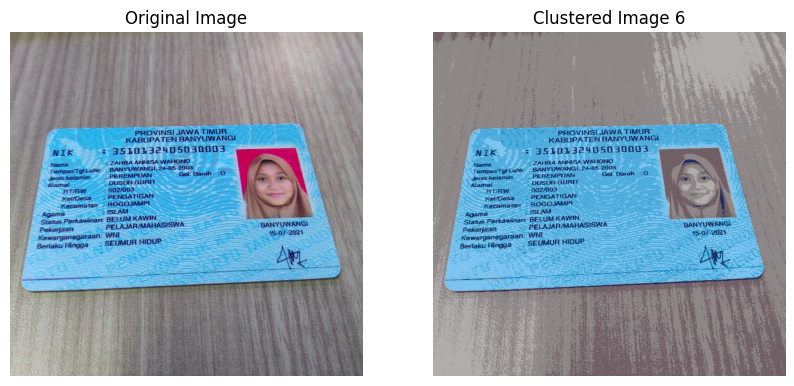

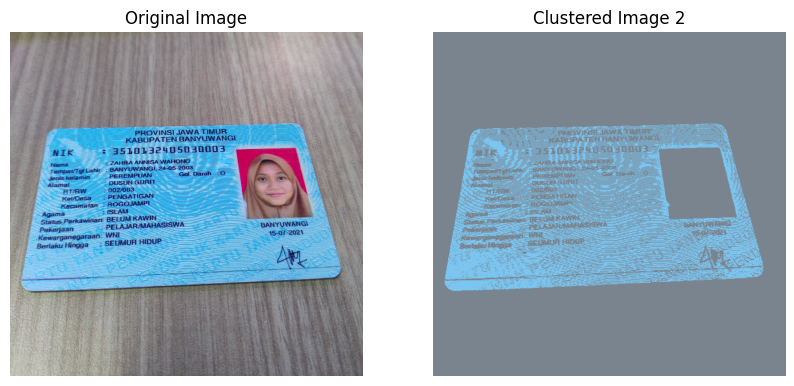

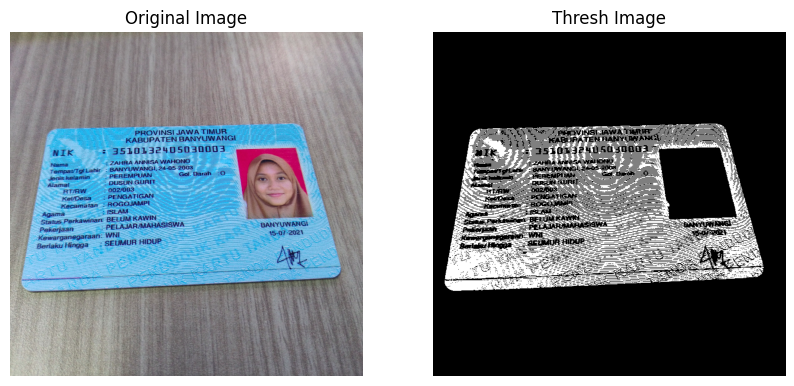

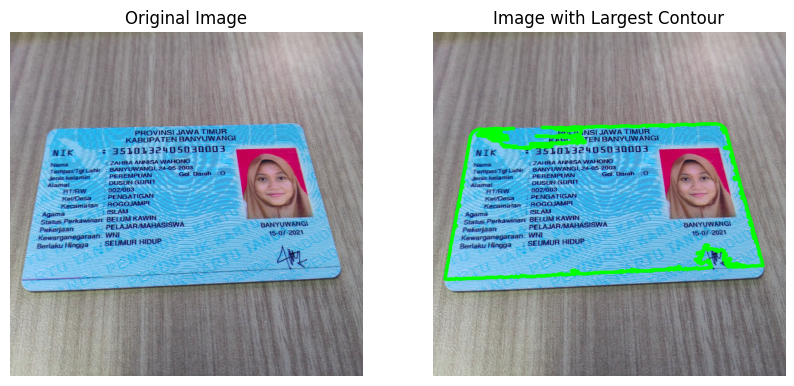

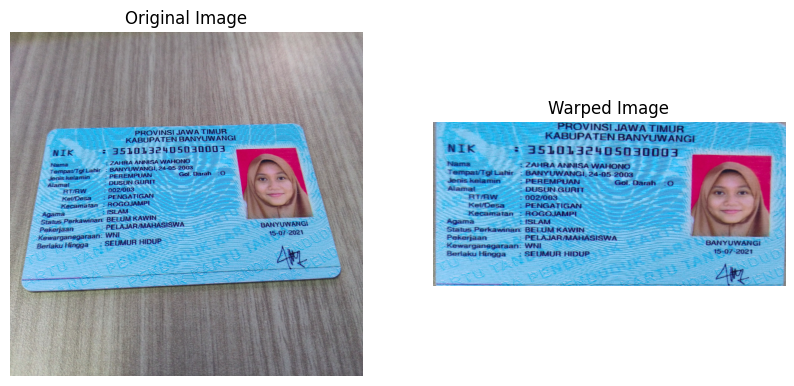

In [ ]:
# Iterate over all files in the folder
idx = 23
for i,filename in enumerate(os.listdir(folder_path)):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        num_digits = len(str(len(os.listdir(folder_path))))

        file_ext = os.path.splitext(filename)[1]

        # Read the image
        image_path = os.path.join(folder_path, filename)

        img = cv2.imread(image_path)

        img = reshape_image(img)

        clustered = []

        clustered_img = clustering(img)

        compare_images(img, "Original Image", clustered_img, "Clustered Image 2")

        gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

        upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        compare_images(img, "Original Image", thresh_img, "Thresh Image")

        # Find and draw the largest contour
        largest_contour = find_and_draw_largest_contour(img.copy(), thresh_img)


        # If not found contour
        epsilon = 0.02 * cv2.arcLength(largest_contour, True)
        approx = cv2.approxPolyDP(largest_contour, epsilon, True)

        if len(approx) != 4:
          largest_contour = SecondOption(img)

        # Perform perspective transformation
        warped_image = perspective_transform(img.copy(), largest_contour)
        cv2.imwrite(f"/content/drive/MyDrive/pcvk/uas/result-cropped/{idx:0{num_digits}d}{file_ext}", warped_image)
        idx = idx + 1

# Optional 2 (ktp telat upload)

In [ ]:
# Folder path containing images
folder_path = '/content/drive/MyDrive/pcvk/uas/datatest-uncrop2/'

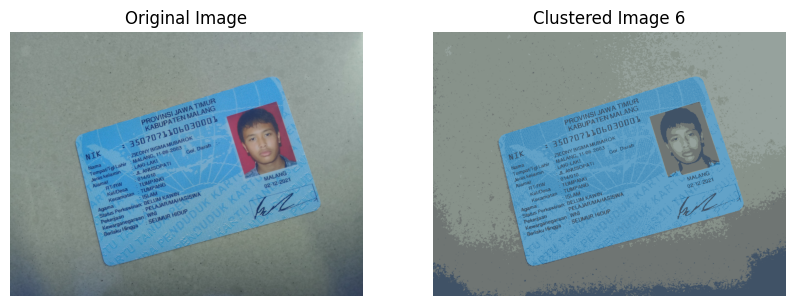

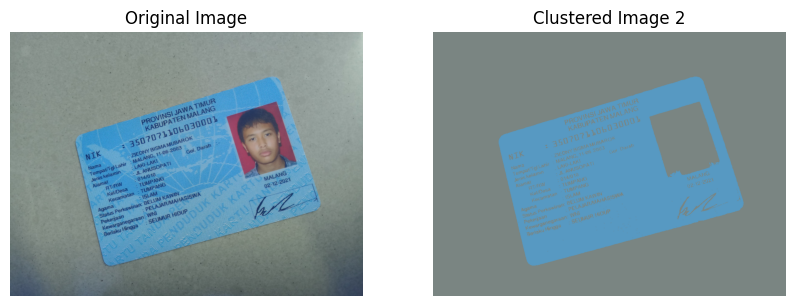

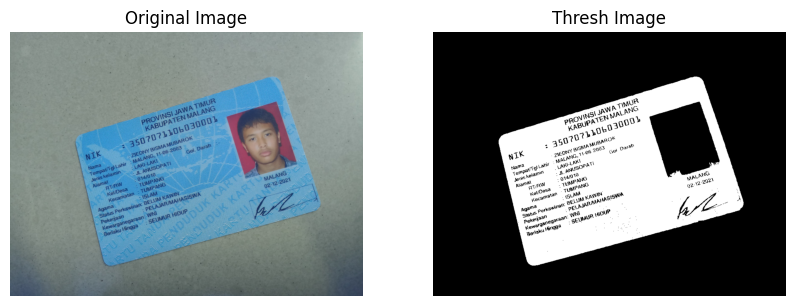

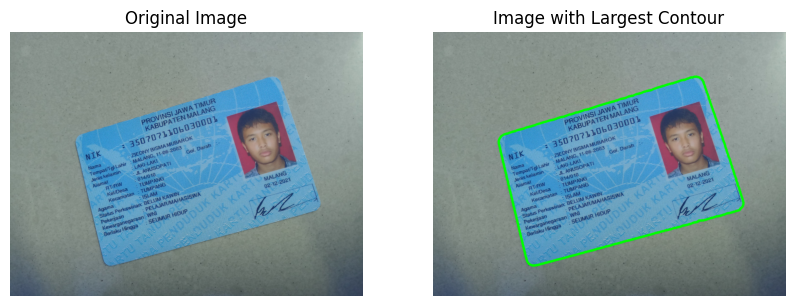

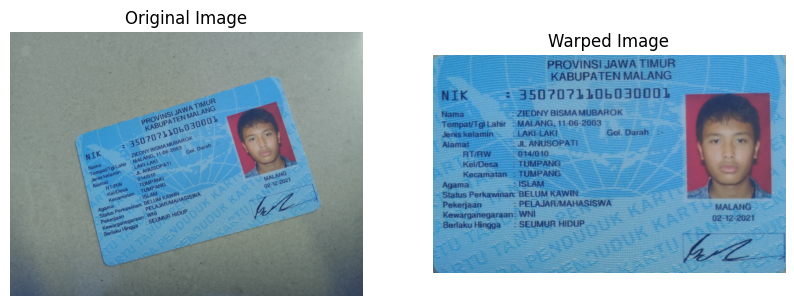

In [ ]:
# Iterate over all files in the folder
idx = 27
for i,filename in enumerate(os.listdir(folder_path)):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        num_digits = len(str(len(os.listdir(folder_path))))

        file_ext = os.path.splitext(filename)[1]

        # Read the image
        image_path = os.path.join(folder_path, filename)

        img = cv2.imread(image_path)

        img = reshape_image(img)

        clustered = []

        clustered_img = clustering(img)

        compare_images(img, "Original Image", clustered_img, "Clustered Image 2")

        gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

        upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        compare_images(img, "Original Image", thresh_img, "Thresh Image")

        # Find and draw the largest contour
        largest_contour = find_and_draw_largest_contour(img.copy(), thresh_img)


        # If not found contour
        epsilon = 0.02 * cv2.arcLength(largest_contour, True)
        approx = cv2.approxPolyDP(largest_contour, epsilon, True)

        if len(approx) != 4:
          largest_contour = SecondOption(img)

        # Perform perspective transformation
        warped_image = perspective_transform(img.copy(), largest_contour)
        cv2.imwrite(f"/content/drive/MyDrive/pcvk/uas/result-cropped/{idx:0{num_digits}d}{file_ext}", warped_image)
        idx = idx + 1

# Optional 3 (telat upload lagi)

In [ ]:
# Folder path containing images
folder_path = '/content/drive/MyDrive/pcvk/uas/datatest-uncrop3/'

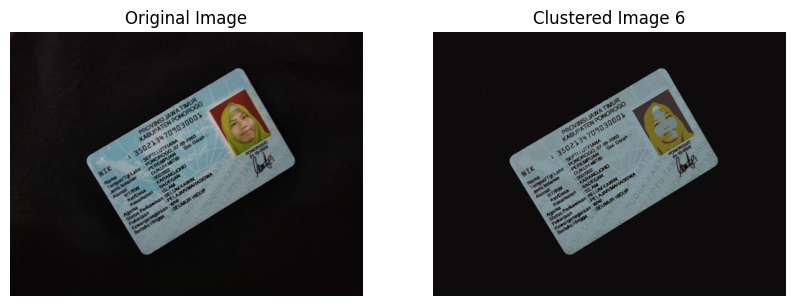

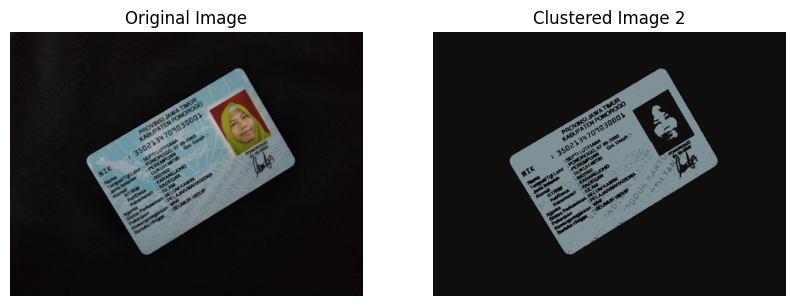

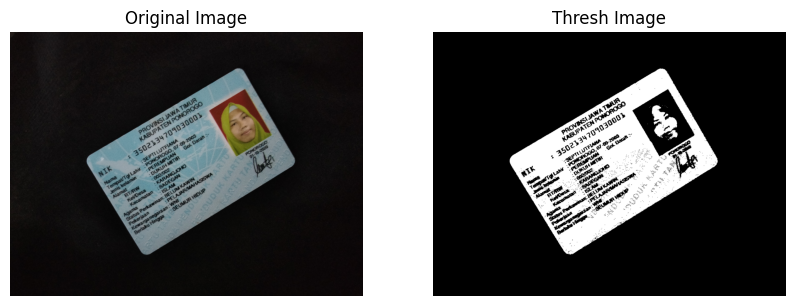

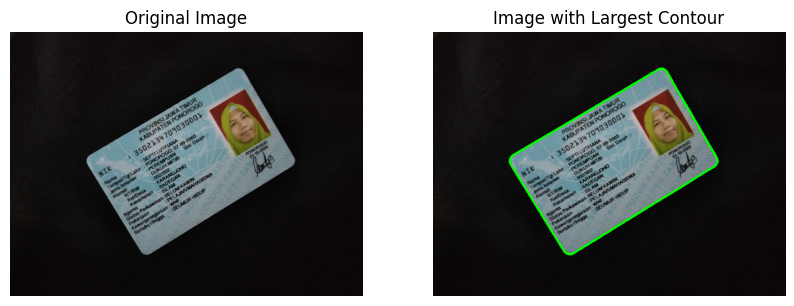

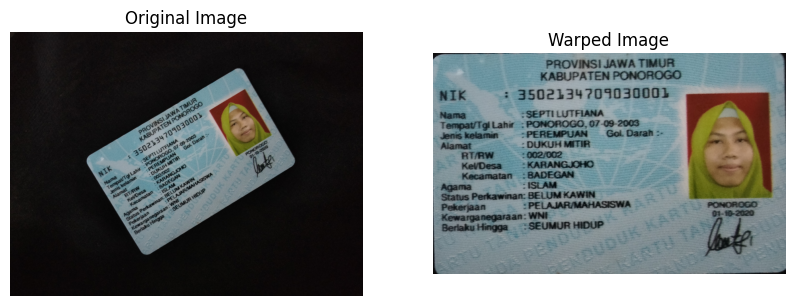

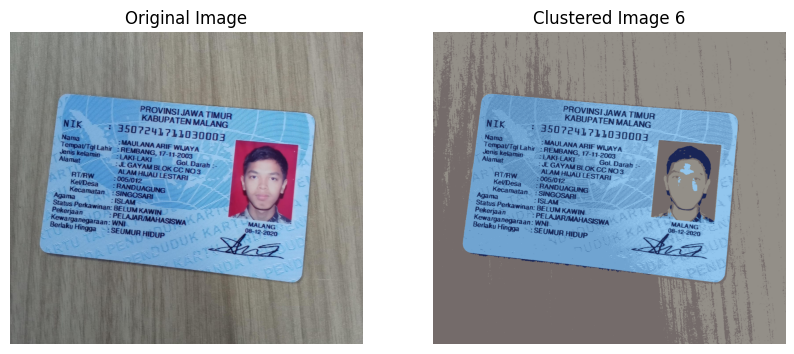

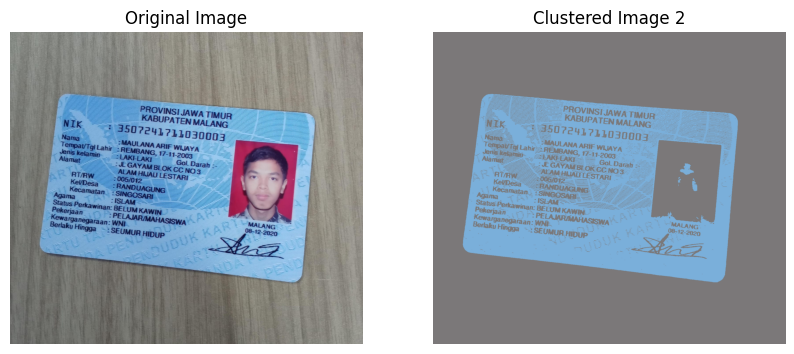

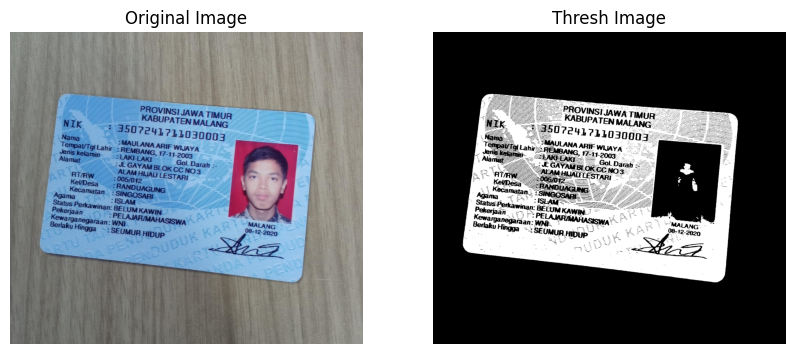

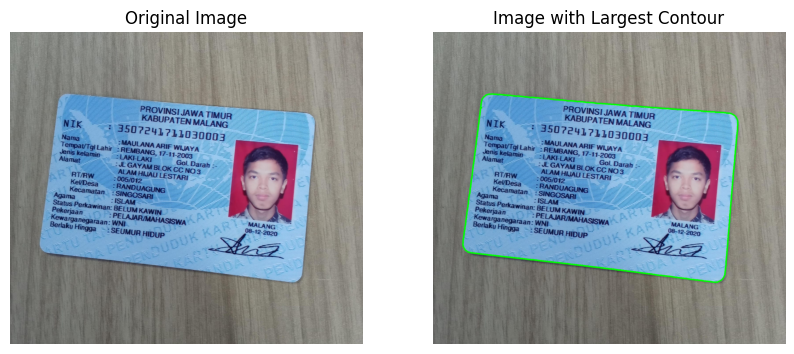

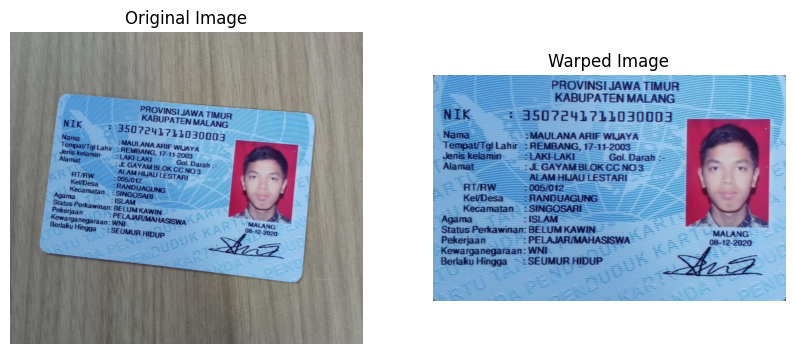

In [ ]:
idx = 28
for i,filename in enumerate(os.listdir(folder_path)):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        num_digits = len(str(len(os.listdir(folder_path))))

        file_ext = os.path.splitext(filename)[1]

        # Read the image
        image_path = os.path.join(folder_path, filename)

        img = cv2.imread(image_path)

        img = reshape_image(img)

        clustered = []

        clustered_img = clustering(img)

        compare_images(img, "Original Image", clustered_img, "Clustered Image 2")

        gray_img = cv2.cvtColor(clustered_img, cv2.COLOR_BGR2GRAY)

        upper_thresh, thresh_img = cv2.threshold(gray_img, thresh=0, maxval=255, type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        compare_images(img, "Original Image", thresh_img, "Thresh Image")

        # Find and draw the largest contour
        largest_contour = find_and_draw_largest_contour(img.copy(), thresh_img)


        # If not found contour
        epsilon = 0.02 * cv2.arcLength(largest_contour, True)
        approx = cv2.approxPolyDP(largest_contour, epsilon, True)

        if len(approx) != 4:
          largest_contour = SecondOption(img)

        # Perform perspective transformation
        warped_image = perspective_transform(img.copy(), largest_contour)
        cv2.imwrite(f"/content/drive/MyDrive/pcvk/uas/result-cropped/{idx:0{num_digits}d}{file_ext}", warped_image)
        idx = idx + 1